<div style="background-color: #ccffcc; padding: 10px;">
    <h1> Tutorial 2 </h1> 
    <h2> Physics Informed Neural Networks Part 2</h2>
    <h2> Heat PINNs Equation Example </h2>
</div>    

# Overview

This notebook is based on two papers: *[Physics-Informed Neural Networks:  A Deep LearningFramework for Solving Forward and Inverse ProblemsInvolving Nonlinear Partial Differential Equations](https://www.sciencedirect.com/science/article/pii/S0021999118307125)* and *[Hidden Physics Models:  Machine Learning of NonlinearPartial Differential Equations](https://www.sciencedirect.com/science/article/pii/S0021999117309014)* with the help of  Fergus Shone and Michael Macraild.

These tutorials will go through solving Partial Differential Equations using Physics Informed Neuaral Networks focusing on the Burgers Equation and a more complex example using the Navier Stokes Equation

**This introduction section is replicated in all PINN tutorial notebooks (please skip if you've already been through)** 

<div style="background-color: #cce5ff; padding: 10px;">

If you have not already then in your gitbash or terminal please run the following code in the LIFD_ENV_ML_NOTEBOOKS directory. 
    
```bash
git submodule init
git submodule update --init --recursive
```
    
</div>

<div style="background-color: #ccffcc; padding: 10px;">

<h1>Physics Informed Neural Networks</h1>

For a typical Neural Network using algorithims like gradient descent to look for a hypothesis, data is the only guide, however if the data is noisy or sparse and we already have governing physical models we can use the knowledge we already know to optamize and inform the algoithms. This can be done via [feature enginnering]() or by adding a physicall inconsistency term to the loss function.
<a href="https://towardsdatascience.com/physics-guided-neural-networks-pgnns-8fe9dbad9414">
<img src="https://miro.medium.com/max/700/1*uM2Qh4PFQLWLLI_KHbgaVw.png">
</a>   
  
 
## The very basics

If you know nothing about neural networks there is a [toy neural network python code example](https://github.com/cemac/LIFD_ENV_ML_NOTEBOOKS/tree/main/ToyNeuralNetwork) included in the [LIFD ENV ML Notebooks Repository]( https://github.com/cemac/LIFD_ENV_ML_NOTEBOOKS). Creating a 2 layer neural network to illustrate the fundamentals of how Neural Networks work and the equivlent code using the python machine learning library [tensorflow](https://keras.io/). 

    
## Recommended reading 
    
The in-depth theory behind neural networks will not be covered here as this tutorial is focusing on application of machine learning methods. If you wish to learn more here are some great starting points.   

* [All you need to know on Neural networks](https://towardsdatascience.com/nns-aynk-c34efe37f15a) 
* [Introduction to Neural Networks](https://victorzhou.com/blog/intro-to-neural-networks/)
* [Physics Guided Neural Networks](https://towardsdatascience.com/physics-guided-neural-networks-pgnns-8fe9dbad9414)
* [Maziar Rassi's Physics informed GitHub web Page](https://maziarraissi.github.io/PINNs/)

</div>


<hr>


<div style="background-color: #e6ccff; padding: 10px;">
    
<h1> Machine Learning Theory </h1>
<a href="https://victorzhou.com/series/neural-networks-from-scratch/">
<img src="https://victorzhou.com/media/nn-series/network.svg">
</a>

    
## Physics informed Neural Networks

Neural networks work by using lots of data to calculate weights and biases from data alone to minimise the loss function enabling them to act as universal fuction approximators. However these loose their robustness when data is limited. However by using know physical laws or empirical validated relationships the solutions from neural networks can be sufficiently constrianed by disregardins no realistic solutions.
    
A Physics Informed Nueral Network considers a parameterized and nonlinear partial differential equation in the genral form;
$$
\begin{align}
     u_t + \mathcal{N}[u; \lambda] &= 0, && x \in \Omega, t \in [0,T],\\
\end{align}
$$

where $\mathcal{u(t,x)}$ denores the hidden solution, $\mathcal{N}$ is a nonlinear differential operator acting on $u$, $\mathcal{\lambda}$ and $\Omega$ is a \subset of \mathbb{R}^D$ (the perscribed data). This set up an encapuslate a wide range of problems such as diffusion processes, conservation laws,  advection-diffusion-reaction  systems,  and  kinetic  equations and conservation laws. 

Here we will go though this for the Burgers equation and Navier stokes equations


</div>    

<div style="background-color: #cce5ff; padding: 10px;">

<h1> Python </h1>

    
## Tensorflow 
    
There are many machine learning python libraries available, [TensorFlow](https://www.tensorflow.org/) a is one such library. If you have GPUs on the machine you are using TensorFlow will automatically use them and run the code even faster!

## Further Reading

* [Running Jupyter Notebooks](https://jupyter.readthedocs.io/en/latest/running.html#running)
* [Tensorflow optimizers](https://www.tutorialspoint.com/tensorflow/tensorflow_optimizers.htm)

</div>
    
<hr>

<div style="background-color: #ffffcc; padding: 10px;">
    
<h1> Requirements </h1>

These notebooks should run with the following requirements satisfied

<h2> Python Packages: </h2>

* Python 3
* tensorflow > 2
* numpy as np
* matplotlib
* scipy

<h2> Data Requirements</h2>
    
This notebook referes to some data included in the git hub repositroy
    
</div>


**Contents:**

1. [1D Heat Equation Non ML Example](PINNs_1DHeatEquations_nonML.ipynb)
2. **[Burgers Equation PINN Example](PINNs_BurgersEquationExample.ipynb)**
3. [Navier-Stokes PINNs discovery of PDE’s](PINNs_Navier_Stokes_example.ipynb)


<div style="background-color: #cce5ff; padding: 10px;">
Load in all required modules (includig some auxillary code) and turn off warnings. Make sure Keras session is clear
</div>

In [1]:
# For readability: disable warnings
import warnings
warnings.filterwarnings('ignore')

In [18]:
import sys
import os
sys.path.insert(0, 'PINNs/Utilities/')
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import scipy.io
from scipy.interpolate import griddata
import time
from itertools import product, combinations
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.gridspec as gridspec
from time import time
import scipy.sparse as sp
import scipy.sparse.linalg as la
import subprocess
subprocess.check_call([sys.executable, "-m", "pip", "install", "pyDOE"])
from pyDOE import lhs

<hr>

# Solving 1D heat equations via Neural Networks

<div style="background-color: #ccffcc; padding: 10px;">

**Model Problem: 1D Heat Equation**

We begin by describing the first model problem - the one-dimensional heat equation. 

The heat equation is the prototypical parabolic partial differential equation and can be applied to modelling the diffusion of heat through a given region, hence its name. Read more about the heat equation here: https://en.wikipedia.org/wiki/Heat_equation.

In 1D, the heat equation can be written as:

$$\frac{\partial u}{\partial t} = k \frac{\partial^2 u}{\partial x^2 },$$

where $k$ is a material parameter called the coefficient of thermal diffusivitiy.

This equation can be solved using numerical methods, such as finite differences or finite elements. For this notebook, we have solved the above equation numerically on a domain of $x \in [0,1]$ and $t \in [0, 0.25]$. Solving this equation numerically gives us a spatiomtemporal domain $(x,t)$ and corresponding values of the solution $u$.

</div>
    
<div style="background-color: #e6ccff; padding: 10px;">

    
Here we will describe the architecture of the PINN we use to solve the 1D heat equation in this notebook. 
![PINNS.png](PINNS.png)
    
    
Net U in the above diagram approximations a function that maps from $(x,t) \mapsto u$. $\sigma$ represents the biases and weights for the each neuron of the network. These $\sigma$ values are the network parameters that are updated after each iteration. AD means Automatic Differentiation - this is the chain rule-based differentiation procedure that allows for differentiation of network outputs with respect to its inputs, e.g. differenting $u$ with respect to $x$, or calculating $\frac{\partial u}{\partial x}$. The I node in the AD section represents the identity operation, i.e. keeping $u$ fixed without applying any differentiation. 

After the automatic differentiation part of the network, we have two separate loss function components - the data loss and the PDE loss. The data loss term is calculated by finding the difference between the network outputs/predictions $u$ and the ground truth values of $u$, which could come from simulation or experiment. The data loss term enforces the network outputs to match known data points, which are represented by the pink box labelled "Data". The PDE loss term is where we add the "physics-informed" part of the network. Using automatic differentiation, we are able to calculate derivatives of our network outputs, and so we are able to construct a loss function that enforces the network to match the PDE that is known to govern the system. In this case, the PDE loss term is defined as:
$$ f = \frac{\partial u}{\partial t} - k \frac{\partial^2 u}{\partial x^2 },$$
where f is the residual of the 1D heat equation. By demanding that $f$ is minimised as our network train, we ensure that the network outputs obey the underlying PDE that governs the system. We then calculate the total loss of the system as a sum of the data loss and the PDE loss.

The loss is calculated after each pass through the network and when it is above a certain tolerance, the weights and biases are updated using a gradient descent step. When the loss falls below the tolerance the network is trained. In inference mode, we can then input a fine mesh of spatiomteporal coordinates and the network will find the solution at each of these points.
    
</div>

<hr>
<div style="background-color: #ccffcc; padding: 10px;">

**$u(x,t)$** can then be defined below as the function `net_u` and the physics informed neural network **$f(x,t)$** is outline in function `net_f`

</div>

In [3]:
def neural_net(X, weights, biases,lb,ub):
    num_layers = len(weights) + 1

    H = 2.0*(X - lb)/(ub - lb) - 1.0
    for l in range(0,num_layers-2):
        W = weights[l]
        b = biases[l]
        H = tf.tanh(tf.add(tf.matmul(H, W), b))
    W = weights[-1]
    b = biases[-1]
    Y = tf.add(tf.matmul(H, W), b)
    return Y

def net_u(x_tf, t_tf, weights, biases, lb, ub):  
    u = neural_net(tf.concat([x_tf,t_tf],1), weights, biases, lb, ub)
    return u

def net_f(x_tf, t_tf, weights, biases,lb, ub,k): 
    u = net_u(x_tf,t_tf,weights, biases, lb, ub)
    u_t = tf.gradients(u, t_tf)[0]
    u_x = tf.gradients(u, x_tf)[0]
    u_xx = tf.gradients(u_x, x_tf)[0]
    f = k*u_xx
    return f

<hr>
<div style="background-color: #ccffcc; padding: 10px;">
    
###  Intialise everying 
    
the `init` function will take our gridded data X and U initialised it building our neural networks from the functions defined above ready to train the model

Variables to be deffined here:

`X_u`: Input coordinates, e.g. spatial and temporal coordinates.

`u`: Output corresponding to each input coordinate. 

`X_f`: Collocation points at which the governing equations are satisfied. These coordinates will have the same format as the X_u coordinates, e.g. $(x,t)$.

layers: Specifies the structure of the u network.

`lb`: Vector containing the lower bound of all of the coordinate variables, e.g. $x_{min}$, $t_{min}$.

`ub`: Vector containing the upper bound of all of the coordinate variables, e.g. $x_{max}$, $t_{max}$.

`k`: This is the constant material parameter for this specific problem. For this problem, the heat equation, $k$ represents thermal diffusivity.
    

    
</div>

In [4]:
def xavier_init( size):
    in_dim = size[0]
    out_dim = size[1]        
    xavier_stddev = np.sqrt(2/(in_dim + out_dim))
    return tf.Variable(tf.random.truncated_normal([in_dim, out_dim], stddev=xavier_stddev), dtype=tf.float32)

def initialize_NN( layers):        
    weights = []
    biases = []
    num_layers = len(layers) 
    for l in range(0,num_layers-1):
        W = xavier_init(size=[layers[l], layers[l+1]])
        b = tf.Variable(tf.zeros([1,layers[l+1]], dtype=tf.float32), dtype=tf.float32)
        weights.append(W)
        biases.append(b)        
    return weights, biases

def init(X, u, layers, lb, ub, k):
        
        tf.compat.v1.disable_eager_execution()
        x = X[:,0:1]
        t = X[:,1:2]
        
        
        layers = layers
        
        # Initialize NN
        weights, biases = initialize_NN(layers)  
        
        # tf placeholders and graph
        sess = tf.compat.v1.Session(config=tf.compat.v1.ConfigProto(allow_soft_placement=True,
                                                     log_device_placement=True))
        # Initialize parameters
        lambda_1 = tf.Variable([0.0], dtype=tf.float32)
        lambda_2 = tf.Variable([-6.0], dtype=tf.float32)
     
        

        x_tf = tf.compat.v1.placeholder(tf.float32, shape=[None, x.shape[1]])
        t_tf = tf.compat.v1.placeholder(tf.float32, shape=[None, t.shape[1]])
        u_tf = tf.compat.v1.placeholder(tf.float32, shape=[None, u.shape[1]])
        
        u_pred = net_u(x_tf, t_tf,weights, biases, lb, ub)
        f_pred = net_f(x_tf, t_tf,weights, biases,lb, ub,k)

        
        loss_PDE = tf.reduce_mean(tf.square(f_pred))
        loss_data = tf.reduce_mean(tf.square(u_tf - u_pred))
        loss = loss_PDE + 5*loss_data
        
        optimizer = tf.compat.v1.train.AdamOptimizer()
        optimizer_Adam = tf.compat.v1.train.AdamOptimizer()
        train_op_Adam = optimizer_Adam.minimize(loss)                    

        init = tf.compat.v1.global_variables_initializer()
        sess.run(init)
        xvars=[X,lb,ub,x,t,u]
        NNvars=[layers, weights, biases, lambda_1, lambda_2]
        tfvars=[sess, x_tf, t_tf ,u_tf]
        preds=[u_pred, f_pred]
        optvars=[loss, optimizer,optimizer_Adam,train_op_Adam]
        return xvars,NNvars,tfvars,preds,optvars

<div style="background-color: #ccffcc; padding: 10px;">

# Load data and set input parameters 
      
A feedforward neural network of the following structure is assumed:
- the input is scaled elementwise to lie in the interval $[-1, 1]$,
- followed by 8 fully connected layers each containing 20 neurons and each followed by a hyperbolic tangent activation function,
- one fully connected output layer.

This setting results in a network with a first hidden layer: $2 \cdot 20 + 20 = 60$; $9$ intermediate layers: each $20 \cdot 20 + 20 = 540$; output layer: $20 \cdot 1 + 1 = 21$).
    

</div>

 <div style="background-color: #cce5ff; padding: 10px;">
    
# Number of collocation points 
    
`2000` colloction points is the default setting for this example this can be increased to improve results at cost of computational speed. The original work set this `N_u=10000` running on GPU's in a few minutes. 
    
    
The network takes in data in coordinate pairs: $(x,t) \mapsto u$.     
</div>

In [5]:

k = 1
N_u = 100 #100 # number of data points
N_f = 2000 # Coloaction points 
# structure of network: two inputs (x,t) and one output u
# 8 fully connected layers with 20 nodes per layer
layers = [2, 20, 20, 20, 20, 20, 20, 20, 20, 1]
data = scipy.io.loadmat("Data/heatEquation_data.mat")
t = data['t'].flatten()[:,None] # read in t and flatten into column vector
x = data['x'].flatten()[:,None] # read in x and flatten into column vector
 # Exact represents the exact solution to the problem, from the Matlab script provided
Exact = np.real(data['usol']).T # Exact has structure of nx times nt


# print("t = ", t.transpose())
# print("x = ", x.transpose())
print("usol shape = ", Exact.shape)

# We need to find all the x,t coordinate pairs in the domain
X, T = np.meshgrid(x,t)

# Flatten the coordinate grid into pairs of x,t coordinates
X_star = np.hstack((X.flatten()[:,None], T.flatten()[:,None])) # coordinates x,t
u_star = Exact.flatten()[:,None]   # corresponding solution value with each coordinate            


print("X has shape ", X.shape, ", X_star has shape ", X_star.shape)
    
# Doman bounds (-1,1)
lb = X_star.min(0)
ub = X_star.max(0)  

print("Lower bounds of x,t: ", lb)
print("Upper bounds of x,t: ", ub)

# ## We train using only boundary points, i.e. at t=0 and x=0,1
# # Extract coordinates of boundary points
# xx1 = np.hstack((X[0:1,:].T, T[0:1,:].T)) # t=0 boundary
# uu1 = Exact[0:1,:].T # u values on t=0 boundary
# xx2 = np.hstack((X[:,0:1], T[:,0:1])) # x=0 boundary
# uu2 = Exact[:,0:1] # u values on x=0 boundary
# xx3 = np.hstack((X[:,-1:], T[:,-1:])) # x=1 boundary
# uu3 = Exact[:,-1:] # u values on x=1 boundary

# X_u_train = np.vstack([xx1, xx2, xx3]) # column vector (x,t) with all boundary data contained
# u_train = np.vstack([uu1, uu2, uu3]) # stack up all u boundary data training coordinates

# Noiseless
noise = 0.0     

## train using internal points
X_u_train = X_star
u_train = u_star

## Generate collocation points using Latin Hypercube sampling within the bounds of the spationtemporal coordinates
# Generate N_f x,t coordinates within range of upper and lower bounds
X_f_train = lb + (ub-lb)*lhs(2, N_f) # the 2 denotes the number of coordinates we have - x,t 

## In addition, we add the X_u_train coordinats from the boundaries to the X_f coordinate set
X_f_train = np.vstack((X_f_train, X_u_train)) # stack up all training x,t coordinates for u and f 

## We downsample the boundary data to leave N_u randomly distributed points
## This makes the training more difficult - 
## if we used all the points then there is not much for the network to do!
idx = np.random.choice(X_star.shape[0], N_u, replace=False)
X_u_train = X_star[idx,:]
u_train = u_star[idx,:]

# print("X_u_train", X_u_train)
# print("u_train", u_train)
# print("X_f_train", X_f_train)

usol shape =  (51, 101)
X has shape  (51, 101) , X_star has shape  (5151, 2)
Lower bounds of x,t:  [0. 0.]
Upper bounds of x,t:  [1.   0.25]


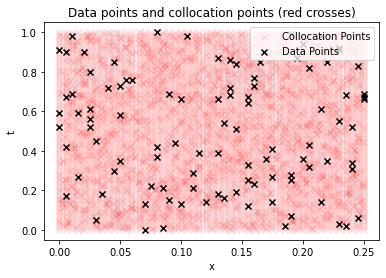

In [6]:
## making a plot to show the distribution of training data
plt.scatter(X_f_train[:,1], X_f_train[:,0], marker='x', color='red',alpha=0.1)
plt.scatter(X_u_train[:,1], X_u_train[:,0], marker='x', color='black')
plt.xlabel('x')
plt.ylabel('t')
plt.title('Data points and collocation points (red crosses)')
plt.legend(['Collocation Points', 'Data Points'])
plt.show()

<div style="background-color: #ccffcc; padding: 10px;">

# Initalise the nerual network 
    
`init` is called passing in the training data `X_u_train` and `u_train` with information about the neural network layers and bounds `lb` `ub`
    
# Extract vars
    
`init` reformats some of the data and outputs model features that we need to pass into the training function `train`

</div>

In [7]:
xvars, NNvars, tfvars, preds, optvars = init(X_u_train, u_train, layers, lb, ub,k)
X,lb,ub,x,t,u=xvars
layers, weights, biases, lambda_1, lambda_2=NNvars
sess, x_tf, t_tf ,u_tf=tfvars
u_pred, f_pred,=preds
loss, optimizer,optimizer_Adam,train_op_Adam=optvars

Device mapping: no known devices.


2021-08-09 08:46:56.650345: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2021-08-09 08:46:56.650876: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2021-08-09 08:46:56.650894: W tensorflow/stream_executor/cuda/cuda_driver.cc:326] failed call to cuInit: UNKNOWN ERROR (303)
2021-08-09 08:46:56.650919: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (marvin): /proc/driver/nvidia/version does not exist


truncated_normal/TruncatedNormal: (TruncatedNormal): /job:localhost/replica:0/task:0/device:CPU:0
truncated_normal/mul: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
truncated_normal: (Add): /job:localhost/replica:0/task:0/device:CPU:0
Variable/IsInitialized/VarIsInitializedOp: (VarIsInitializedOp): /job:localhost/replica:0/task:0/device:CPU:0
Variable/Assign: (AssignVariableOp): /job:localhost/replica:0/task:0/device:CPU:0
Variable/Read/ReadVariableOp: (ReadVariableOp): /job:localhost/replica:0/task:0/device:CPU:0
Variable_1/IsInitialized/VarIsInitializedOp: (VarIsInitializedOp): /job:localhost/replica:0/task:0/device:CPU:0
Variable_1/Assign: (AssignVariableOp): /job:localhost/replica:0/task:0/device:CPU:0
Variable_1/Read/ReadVariableOp: (ReadVariableOp): /job:localhost/replica:0/task:0/device:CPU:0
truncated_normal_1/TruncatedNormal: (TruncatedNormal): /job:localhost/replica:0/task:0/device:CPU:0
truncated_normal_1/mul: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
trunca

2021-08-09 08:46:57.771038: I tensorflow/core/common_runtime/placer.cc:114] truncated_normal/TruncatedNormal: (TruncatedNormal): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 08:46:57.771072: I tensorflow/core/common_runtime/placer.cc:114] truncated_normal/mul: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 08:46:57.771082: I tensorflow/core/common_runtime/placer.cc:114] truncated_normal: (Add): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 08:46:57.771091: I tensorflow/core/common_runtime/placer.cc:114] Variable/IsInitialized/VarIsInitializedOp: (VarIsInitializedOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 08:46:57.771102: I tensorflow/core/common_runtime/placer.cc:114] Variable/Assign: (AssignVariableOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 08:46:57.771109: I tensorflow/core/common_runtime/placer.cc:114] Variable/Read/ReadVariableOp: (ReadVariableOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 08:46:

In [43]:

def train(sess, nIter,x_tf, t_tf, u_tf,x, t,u_train, loss, train_op_Adam, optimizer_Adam, modelname): 
    tf_dict = {x_tf: x,  t_tf: t, u_tf: u}

    start_time = time()
    for it in range(nIter):
        sess.run(train_op_Adam, tf_dict)

    # Print
    if it % 10 == 0:
        elapsed = time() - start_time
        loss_value = sess.run(loss, tf_dict)
        lambda_1_value = sess.run(lambda_1)
        lambda_2_value = sess.run(lambda_2)
        print('It: %d, Loss: %.3e, l1: %.3f, l2: %.5f, Time: %.2f' % 
            (it, loss_value, lambda_1_value, lambda_2_value, elapsed))
        start_time = time()
    
    
    if not os.path.isdir(modelname):
        os.makedirs(modelname)
    
    optimizer.minimize(loss)
  



<div style="background-color: #cce5ff; padding: 10px;">

**Training might take a while depending on value of Train_interations**

If you set Train_iterations too low the end results will be garbage. 20000 was used to achieve excellent results. 

* If you are using a machine with GPUs please set `Train_interations` to 20000 and this will run quickly
* If you are using a well spec'ed laptop/computer and can leave this setting `Train_interations=20000` but it will take upto 10 mins
* If you are using a low spec'ed laptop/computer or cannont leave the code running `Train_interations=10000` is the reccomended value (this solution may not be accurate)
    
</div>

In [44]:
# Training
Train_interations=20000

In [45]:
train(sess, Train_interations,x_tf, t_tf, u_tf,x, t,u_train, loss, train_op_Adam, optimizer_Adam,'1DHeat/')


2021-08-09 09:19:29.319899: I tensorflow/core/common_runtime/placer.cc:114] truncated_normal/TruncatedNormal: (TruncatedNormal): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:19:29.319935: I tensorflow/core/common_runtime/placer.cc:114] truncated_normal/mul: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:19:29.319945: I tensorflow/core/common_runtime/placer.cc:114] truncated_normal: (Add): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:19:29.319952: I tensorflow/core/common_runtime/placer.cc:114] Variable: (VarHandleOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:19:29.319958: I tensorflow/core/common_runtime/placer.cc:114] Variable/IsInitialized/VarIsInitializedOp: (VarIsInitializedOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:19:29.319964: I tensorflow/core/common_runtime/placer.cc:114] Variable/Assign: (AssignVariableOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:19:29.319971: I tensorflow

anhGrad_grad/mul/y: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_9/gradients_1/Add_13_grad/Sum_grad/Size: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_9/gradients_1/Add_13_grad/Sum_grad/range/start: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_9/gradients_1/Add_13_grad/Sum_grad/range/delta: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_9/gradients_1/Add_13_grad/Sum_grad/ones/Const: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_9/gradients_1/Tanh_12_grad/TanhGrad_grad/mul/y: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_9/gradients_1/Add_14_grad/Sum_grad/Size: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_9/gradients_1/Add_14_grad/Sum_grad/range/start: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_9/gradients_1/Add_14_grad/Sum_grad/range/delta: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_9/gradients_1/Add_14_grad/Sum_grad/

/mul_2_grad/BroadcastGradientArgs: (BroadcastGradientArgs): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:19:29.488121: I tensorflow/core/common_runtime/placer.cc:114] gradients_6/gradients_2/gradients_1/Tanh_14_grad/TanhGrad_grad/mul_2_grad/Mul: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:19:29.488126: I tensorflow/core/common_runtime/placer.cc:114] gradients_6/gradients_2/gradients_1/Tanh_14_grad/TanhGrad_grad/mul_2_grad/Sum: (Sum): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:19:29.488130: I tensorflow/core/common_runtime/placer.cc:114] gradients_6/gradients_2/gradients_1/Tanh_14_grad/TanhGrad_grad/mul_2_grad/Reshape: (Reshape): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:19:29.488134: I tensorflow/core/common_runtime/placer.cc:114] gradients_6/gradients_2/gradients_1/Tanh_14_grad/TanhGrad_grad/mul_2_grad/Mul_1: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:19:29.488139: I tensorflow/core/common_runt

hape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/Add_9_grad/Sum_1: (Sum): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/Add_9_grad/Reshape_1: (Reshape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/Add_9_grad/tuple/group_deps: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/Add_9_grad/tuple/control_dependency: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/Add_9_grad/tuple/control_dependency_1: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/AddN_43: (AddN): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/MatMul_9_grad/MatMul: (MatMul): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/MatMul_9_grad/MatMul_1: (MatMul): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/MatMul_9_grad/tuple/group_deps: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/MatMul_9_grad/tuple/control_dependency: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
gradient

vice:CPU:0
2021-08-09 09:19:29.706034: I tensorflow/core/common_runtime/placer.cc:114] Adam_7/update_Variable_2/ResourceApplyAdam/ReadVariableOp: (ReadVariableOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:19:29.706038: I tensorflow/core/common_runtime/placer.cc:114] Adam_7/update_Variable_2/ResourceApplyAdam/ReadVariableOp_1: (ReadVariableOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:19:29.706043: I tensorflow/core/common_runtime/placer.cc:114] Adam_7/update_Variable_2/ResourceApplyAdam: (ResourceApplyAdam): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:19:29.706049: I tensorflow/core/common_runtime/placer.cc:114] Adam_7/update_Variable_3/ResourceApplyAdam/ReadVariableOp: (ReadVariableOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:19:29.706054: I tensorflow/core/common_runtime/placer.cc:114] Adam_7/update_Variable_3/ResourceApplyAdam/ReadVariableOp_1: (ReadVariableOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08

 (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_2/gradients_1/Add_13_grad/Sum_grad/range/start: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_2/gradients_1/Add_13_grad/Sum_grad/range/delta: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_2/gradients_1/Add_13_grad/Sum_grad/ones/Const: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_2/gradients_1/Tanh_12_grad/TanhGrad_grad/mul/y: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_2/gradients_1/Add_14_grad/Sum_grad/Size: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_2/gradients_1/Add_14_grad/Sum_grad/range/start: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_2/gradients_1/Add_14_grad/Sum_grad/range/delta: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_2/gradients_1/Add_14_grad/Sum_grad/ones/Const: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_2/gradients_1/Tanh_13_grad/TanhGrad_grad/mul/y: 

<div style="background-color: #ccffcc; padding: 10px;">

# Use trained model to predict from data sample
    
`predict` will predict `u` using the trained model

</div>

In [46]:

def predict(sess, x_star,u_star, u_pred, f_pred,load_weights):
    if load_weights:
        print('loading weights')
    tf_dict = {x_tf: x_star, t_tf: u_star}
    u_star = sess.run(u_pred, tf_dict)
    f_star = sess.run(f_pred, tf_dict)
        
    

    return u_star, f_star

In [47]:
u_pred, f_pred=preds
u_pred, f_pred = predict(sess,X_star[:,0:1],X_star[:,1:2], u_pred, f_pred,True)

error_u = np.linalg.norm(u_star-u_pred,2)/np.linalg.norm(u_star,2)

loading weights


2021-08-09 09:20:07.092135: I tensorflow/core/common_runtime/placer.cc:114] truncated_normal/TruncatedNormal: (TruncatedNormal): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:07.092176: I tensorflow/core/common_runtime/placer.cc:114] truncated_normal/mul: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:07.092186: I tensorflow/core/common_runtime/placer.cc:114] truncated_normal: (Add): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:07.092193: I tensorflow/core/common_runtime/placer.cc:114] Variable: (VarHandleOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:07.092200: I tensorflow/core/common_runtime/placer.cc:114] Variable/IsInitialized/VarIsInitializedOp: (VarIsInitializedOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:07.092207: I tensorflow/core/common_runtime/placer.cc:114] Variable/Assign: (AssignVariableOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:07.092213: I tensorflow

plica:0/task:0/device:CPU:0
Adam_7/epsilon: (Const): /job:localhost/replica:0/task:0/device:CPU:0
save_4/filename/input: (Const): /job:localhost/replica:0/task:0/device:CPU:0
save_4/SaveV2/tensor_names: (Const): /job:localhost/replica:0/task:0/device:CPU:0
save_4/SaveV2/shape_and_slices: (Const): /job:localhost/replica:0/task:0/device:CPU:0
save_4/RestoreV2/tensor_names: (Const): /job:localhost/replica:0/task:0/device:CPU:0
save_4/RestoreV2/shape_and_slices: (Const): /job:localhost/replica:0/task:0/device:CPU:0
truncated_normal/TruncatedNormal: (TruncatedNormal): /job:localhost/replica:0/task:0/device:CPU:0
truncated_normal/mul: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
truncated_normal: (Add): /job:localhost/replica:0/task:0/device:CPU:0
Variable: (VarHandleOp): /job:localhost/replica:0/task:0/device:CPU:0
Variable/IsInitialized/VarIsInitializedOp: (VarIsInitializedOp): /job:localhost/replica:0/task:0/device:CPU:0
Variable/Assign: (AssignVariableOp): /job:localhost/replica:0


2021-08-09 09:20:07.259506: I tensorflow/core/common_runtime/placer.cc:114] gradients_6/gradients_2/gradients_1/Tanh_9_grad/TanhGrad_grad/mul_1_grad/tuple/control_dependency: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:07.259510: I tensorflow/core/common_runtime/placer.cc:114] gradients_6/gradients_2/gradients_1/Tanh_9_grad/TanhGrad_grad/mul_1_grad/tuple/control_dependency_1: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:07.259514: I tensorflow/core/common_runtime/placer.cc:114] gradients_6/gradients_2/Add_11_grad/Reshape_grad/Shape: (Shape): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:07.259519: I tensorflow/core/common_runtime/placer.cc:114] gradients_6/gradients_2/Add_11_grad/Reshape_grad/Reshape: (Reshape): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:07.259524: I tensorflow/core/common_runtime/placer.cc:114] gradients_6/Add_1_grad/Shape: (Shape): /job:localhost/replica:0/task:0/device:CPU

_grad/tuple/control_dependency_1: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/AddN_31: (AddN): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/MatMul_12_grad/MatMul: (MatMul): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/MatMul_12_grad/MatMul_1: (MatMul): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/MatMul_12_grad/tuple/group_deps: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/MatMul_12_grad/tuple/control_dependency: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/MatMul_12_grad/tuple/control_dependency_1: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/AddN_32: (AddN): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/Tanh_10_grad/TanhGrad: (TanhGrad): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/AddN_33: (AddN): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/AddN_34: (AddN): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/Add_11_

:0/device:CPU:0
2021-08-09 09:20:07.479350: I tensorflow/core/common_runtime/placer.cc:114] gradients_10/gradients_2/gradients_1/Tanh_10_grad/TanhGrad_grad/TanhGrad_grad/mul_1: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:07.479355: I tensorflow/core/common_runtime/placer.cc:114] gradients_10/gradients_2/gradients_1/Tanh_10_grad/TanhGrad_grad/TanhGrad_grad/mul_2: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:07.479360: I tensorflow/core/common_runtime/placer.cc:114] gradients_10/gradients_2/gradients_1/Tanh_10_grad/TanhGrad_grad/TanhGrad_grad/TanhGrad: (TanhGrad): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:07.479365: I tensorflow/core/common_runtime/placer.cc:114] gradients_10/gradients_2/gradients_1/Tanh_10_grad/TanhGrad_grad/TanhGrad_grad/tuple/group_deps: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:07.479372: I tensorflow/core/common_runtime/placer.cc:114] gradients_10/gradients_2/gradients_1

ients_11/Add_7_grad/tuple/control_dependency_1: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_2/mul_1_grad/Mul_1_grad/Shape: (Shape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_2/mul_1_grad/Mul_1_grad/Shape_1: (Shape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_2/mul_1_grad/Mul_1_grad/BroadcastGradientArgs: (BroadcastGradientArgs): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_2/mul_1_grad/Mul_1_grad/Mul: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_2/mul_1_grad/Mul_1_grad/Sum: (Sum): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_2/mul_1_grad/Mul_1_grad/Reshape: (Reshape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_2/mul_1_grad/Mul_1_grad/Mul_1: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_2/mul_1_grad/Mul_1_grad/Sum_1: (Sum): /job:localhost/replica:0/task:0/device:CPU:0
gradi

<div style="background-color: #ccffcc; padding: 10px;">

# Calculate Errors
    
if you have set the number of training interations large enough the errors should be small. **NB** as `lambda 2` is very small itself $(0.003)$ this error might be failry high with out affecting the qualitative prediction 

</div>

In [48]:
print("f_pred mean = ", np.mean(f_pred))
print('Error u: %e' % (error_u))
print('Percent error u: ',  100*error_u)


f_pred mean =  0.012410655
Error u: 1.383962e-01
Percent error u:  13.83962042308729


In [49]:
noise = 0.01        
u_train = u_train + noise*np.std(u_train)*np.random.randn(u_train.shape[0], u_train.shape[1])
xvars, NNvars, tfvars, preds, optvars = init(X_u_train, u_train, layers, lb, ub, k)
X,lb,ub,x,t,u=xvars
layers, weights, biases, lambda_1, lambda_2=NNvars
sess, x_tf, t_tf ,u_tf=tfvars
u_pred, f_pred,=preds
loss, optimizer,optimizer_Adam,train_op_Adam=optvars

Device mapping: no known devices.


2021-08-09 09:20:13.083460: I tensorflow/core/common_runtime/placer.cc:114] truncated_normal/TruncatedNormal: (TruncatedNormal): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:13.083495: I tensorflow/core/common_runtime/placer.cc:114] truncated_normal/mul: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:13.083576: I tensorflow/core/common_runtime/placer.cc:114] truncated_normal: (Add): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:13.083589: I tensorflow/core/common_runtime/placer.cc:114] Variable/IsInitialized/VarIsInitializedOp: (VarIsInitializedOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:13.083599: I tensorflow/core/common_runtime/placer.cc:114] Variable/Assign: (AssignVariableOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:13.083606: I tensorflow/core/common_runtime/placer.cc:114] Variable/Read/ReadVariableOp: (ReadVariableOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:

ce:CPU:0
gradients_11/gradients_1/Tanh_14_grad/TanhGrad_grad/mul/y: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_1/Add_16_grad/Sum_grad/Size: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_1/Add_16_grad/Sum_grad/range/start: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_1/Add_16_grad/Sum_grad/range/delta: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_1/Add_16_grad/Sum_grad/ones/Const: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_1/Tanh_15_grad/TanhGrad_grad/mul/y: (Const): /job:localhost/replica:0/task:0/device:CPU:0
Adam_8/learning_rate: (Const): /job:localhost/replica:0/task:0/device:CPU:0
Adam_8/beta1: (Const): /job:localhost/replica:0/task:0/device:CPU:0
Adam_8/beta2: (Const): /job:localhost/replica:0/task:0/device:CPU:0
Adam_8/epsilon: (Const): /job:localhost/replica:0/task:0/device:CPU:0
truncated_normal/TruncatedNormal: (Trun

me/placer.cc:114] gradients_6/gradients_2/Tanh_12_grad/TanhGrad_grad/mul_1: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:13.258701: I tensorflow/core/common_runtime/placer.cc:114] gradients_6/gradients_2/Tanh_12_grad/TanhGrad_grad/mul_2: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:13.258708: I tensorflow/core/common_runtime/placer.cc:114] gradients_6/gradients_2/Tanh_12_grad/TanhGrad_grad/TanhGrad: (TanhGrad): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:13.258714: I tensorflow/core/common_runtime/placer.cc:114] gradients_6/gradients_2/Tanh_12_grad/TanhGrad_grad/tuple/group_deps: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:13.258722: I tensorflow/core/common_runtime/placer.cc:114] gradients_6/gradients_2/Tanh_12_grad/TanhGrad_grad/tuple/control_dependency: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:13.258730: I tensorflow/core/common_runtime/placer.cc:114] gradient

adcastTo_grad/Sum: (Sum): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/gradients_2/gradients_1/Add_14_grad/Sum_grad/BroadcastTo_grad/Reshape: (Reshape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/gradients_2/gradients_1/Add_14_grad/Sum_grad/Reshape_grad/Shape: (Shape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/gradients_2/gradients_1/Add_14_grad/Sum_grad/Reshape_grad/Reshape: (Reshape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/gradients_2/gradients_1/Add_14_grad/Reshape_grad/Reshape_grad/Shape: (Shape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/gradients_2/gradients_1/Add_14_grad/Reshape_grad/Reshape_grad/Reshape: (Reshape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/gradients_2/gradients_1/MatMul_14_grad/MatMul_grad/MatMul_grad/MatMul: (MatMul): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/gradients_2/gradients_1/MatMul_14_grad/MatMul_grad/MatMul_grad/MatMul_1: (MatMul): /job:localhost/re

 I tensorflow/core/common_runtime/placer.cc:114] gradients_10/AddN_41: (AddN): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:13.490987: I tensorflow/core/common_runtime/placer.cc:114] gradients_10/AddN_42: (AddN): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:13.491192: I tensorflow/core/common_runtime/placer.cc:114] gradients_10/Add_9_grad/Shape: (Shape): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:13.491199: I tensorflow/core/common_runtime/placer.cc:114] gradients_10/Add_9_grad/Shape_1: (Shape): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:13.491206: I tensorflow/core/common_runtime/placer.cc:114] gradients_10/Add_9_grad/BroadcastGradientArgs: (BroadcastGradientArgs): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:13.491212: I tensorflow/core/common_runtime/placer.cc:114] gradients_10/Add_9_grad/Sum: (Sum): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 09:20:13.491216: I tensorflow/core/commo

a:0/task:0/device:CPU:0
gradients_11/gradients_2/gradients_1/Tanh_11_grad/TanhGrad_grad/mul_1_grad/tuple/group_deps: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_2/gradients_1/Tanh_11_grad/TanhGrad_grad/mul_1_grad/tuple/control_dependency: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_2/gradients_1/Tanh_11_grad/TanhGrad_grad/mul_1_grad/tuple/control_dependency_1: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_2/Add_13_grad/Reshape_grad/Shape: (Shape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_2/Add_13_grad/Reshape_grad/Reshape: (Reshape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_2/gradients_1/Tanh_11_grad/TanhGrad_grad/mul_grad/Shape: (Shape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gradients_2/gradients_1/Tanh_11_grad/TanhGrad_grad/mul_grad/Shape_1: (Shape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_11/gra

<div style="background-color: #cce5ff; padding: 10px;">

**Training might take a while depending on value of Train_interations**

If you set Train_iterations too low the end results will be garbage. 20000 was used to achieve excellent results. 

* If you are using a machine with GPUs please set `Train_interations` to 20000 and this will run quickly
* If you are using a well spec'ed laptop/computer and can leave this setting `Train_interations=20000` but it will take upto 10 mins
* If you are using a low spec'ed laptop/computer or cannont leave the code running `Train_interations=10000` is the reccomended value (this solution may not be accurate)
    
</div>

In [50]:
Train_interations=200000

In [51]:
train(sess, Train_interations,x_tf, t_tf, u_tf,x, t,u_train, loss, train_op_Adam, optimizer_Adam,'noisey1DHeat/')

In [53]:
u_pred, f_pred=preds
u_pred, f_pred = predict(sess,X_star[:,0:1],X_star[:,1:2], u_pred, f_pred,False)

error_u = np.linalg.norm(u_star-u_pred,2)/np.linalg.norm(u_star,2)


2021-08-09 10:12:11.254142: I tensorflow/core/common_runtime/placer.cc:114] truncated_normal/TruncatedNormal: (TruncatedNormal): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.254181: I tensorflow/core/common_runtime/placer.cc:114] truncated_normal/mul: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.254190: I tensorflow/core/common_runtime/placer.cc:114] truncated_normal: (Add): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.254198: I tensorflow/core/common_runtime/placer.cc:114] Variable: (VarHandleOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.254204: I tensorflow/core/common_runtime/placer.cc:114] Variable/IsInitialized/VarIsInitializedOp: (VarIsInitializedOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.254210: I tensorflow/core/common_runtime/placer.cc:114] Variable/Assign: (AssignVariableOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.254216: I tensorflow

33/Adam: (VarHandleOp): /job:localhost/replica:0/task:0/device:CPU:0
Variable_33/Adam_1/Initializer/zeros: (Const): /job:localhost/replica:0/task:0/device:CPU:0
Variable_33/Adam_1: (VarHandleOp): /job:localhost/replica:0/task:0/device:CPU:0
Variable_34/Adam/Initializer/zeros: (Const): /job:localhost/replica:0/task:0/device:CPU:0
Variable_34/Adam: (VarHandleOp): /job:localhost/replica:0/task:0/device:CPU:0
Variable_34/Adam_1/Initializer/zeros: (Const): /job:localhost/replica:0/task:0/device:CPU:0
Variable_34/Adam_1: (VarHandleOp): /job:localhost/replica:0/task:0/device:CPU:0
Variable_35/Adam/Initializer/zeros: (Const): /job:localhost/replica:0/task:0/device:CPU:0
Variable_35/Adam: (VarHandleOp): /job:localhost/replica:0/task:0/device:CPU:0
Variable_35/Adam_1/Initializer/zeros: (Const): /job:localhost/replica:0/task:0/device:CPU:0
Variable_35/Adam_1: (VarHandleOp): /job:localhost/replica:0/task:0/device:CPU:0
Variable_36/Adam/Initializer/zeros: (Const): /job:localhost/replica:0/task:0/de

plica:0/task:0/device:CPU:0
2021-08-09 10:12:11.427603: I tensorflow/core/common_runtime/placer.cc:114] gradients_6/gradients_2/gradients_1/Tanh_8_grad/TanhGrad_grad/mul_1_grad/tuple/group_deps: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.427611: I tensorflow/core/common_runtime/placer.cc:114] gradients_6/gradients_2/gradients_1/Tanh_8_grad/TanhGrad_grad/mul_1_grad/tuple/control_dependency: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.427619: I tensorflow/core/common_runtime/placer.cc:114] gradients_6/gradients_2/gradients_1/Tanh_8_grad/TanhGrad_grad/mul_1_grad/tuple/control_dependency_1: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.427629: I tensorflow/core/common_runtime/placer.cc:114] gradients_6/gradients_2/Add_10_grad/Reshape_grad/Shape: (Shape): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.427638: I tensorflow/core/common_runtime/placer.cc:114] gradients_6/gradients_2/

_1/Tanh_13_grad/TanhGrad_grad/mul_2_grad/Sum: (Sum): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/gradients_2/gradients_1/Tanh_13_grad/TanhGrad_grad/mul_2_grad/Reshape: (Reshape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/gradients_2/gradients_1/Tanh_13_grad/TanhGrad_grad/mul_2_grad/Mul_1: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/gradients_2/gradients_1/Tanh_13_grad/TanhGrad_grad/mul_2_grad/Sum_1: (Sum): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/gradients_2/gradients_1/Tanh_13_grad/TanhGrad_grad/mul_2_grad/Reshape_1: (Reshape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/gradients_2/gradients_1/Tanh_13_grad/TanhGrad_grad/mul_2_grad/tuple/group_deps: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/gradients_2/gradients_1/Tanh_13_grad/TanhGrad_grad/mul_2_grad/tuple/control_dependency: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
gradients_6/gradients_2/gradients_1/Tanh_13_grad/TanhG

low/core/common_runtime/placer.cc:114] gradients_9/gradients_2/MatMul_16_grad/MatMul_grad/MatMul_1: (MatMul): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.718716: I tensorflow/core/common_runtime/placer.cc:114] gradients_9/gradients_2/MatMul_16_grad/MatMul_grad/tuple/group_deps: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.718724: I tensorflow/core/common_runtime/placer.cc:114] gradients_9/gradients_2/MatMul_16_grad/MatMul_grad/tuple/control_dependency: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.718729: I tensorflow/core/common_runtime/placer.cc:114] gradients_9/gradients_2/MatMul_16_grad/MatMul_grad/tuple/control_dependency_1: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.718737: I tensorflow/core/common_runtime/placer.cc:114] gradients_9/gradients_2/gradients_1/Tanh_14_grad/TanhGrad_grad/mul_1_grad/Shape: (Shape): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:

gradients_10/Add_10_grad/BroadcastGradientArgs: (BroadcastGradientArgs): /job:localhost/replica:0/task:0/device:CPU:0
gradients_10/Add_10_grad/Sum: (Sum): /job:localhost/replica:0/task:0/device:CPU:0
gradients_10/Add_10_grad/Reshape: (Reshape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_10/Add_10_grad/Sum_1: (Sum): /job:localhost/replica:0/task:0/device:CPU:0
gradients_10/Add_10_grad/Reshape_1: (Reshape): /job:localhost/replica:0/task:0/device:CPU:0
gradients_10/Add_10_grad/tuple/group_deps: (NoOp): /job:localhost/replica:0/task:0/device:CPU:0
gradients_10/Add_10_grad/tuple/control_dependency: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
gradients_10/Add_10_grad/tuple/control_dependency_1: (Identity): /job:localhost/replica:0/task:0/device:CPU:0
gradients_10/AddN_39: (AddN): /job:localhost/replica:0/task:0/device:CPU:0
gradients_10/MatMul_10_grad/MatMul: (MatMul): /job:localhost/replica:0/task:0/device:CPU:0
gradients_10/MatMul_10_grad/MatMul_1: (MatMul): /job:l

I tensorflow/core/common_runtime/placer.cc:114] gradients_16/gradients_13/Add_29_grad/Sum_grad/Reshape: (Reshape): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.949858: I tensorflow/core/common_runtime/placer.cc:114] gradients_16/gradients_13/Add_29_grad/Sum_grad/BroadcastTo: (BroadcastTo): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.949863: I tensorflow/core/common_runtime/placer.cc:114] gradients_16/gradients_13/Tanh_25_grad/TanhGrad_grad/mul: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.949867: I tensorflow/core/common_runtime/placer.cc:114] gradients_16/gradients_13/Tanh_25_grad/TanhGrad_grad/mul_1: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.949872: I tensorflow/core/common_runtime/placer.cc:114] gradients_16/gradients_13/Tanh_25_grad/TanhGrad_grad/mul_2: (Mul): /job:localhost/replica:0/task:0/device:CPU:0
2021-08-09 10:12:11.950177: I tensorflow/core/common_runtime/placer.cc:114] gradie

PU:0
gradients_10/gradients_1/Add_10_grad/Sum_grad/Size: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_10/gradients_1/Add_10_grad/Sum_grad/range/start: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_10/gradients_1/Add_10_grad/Sum_grad/range/delta: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_10/gradients_1/Add_10_grad/Sum_grad/ones/Const: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_10/gradients_1/Tanh_9_grad/TanhGrad_grad/mul/y: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_10/gradients_1/Add_11_grad/Sum_grad/Size: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_10/gradients_1/Add_11_grad/Sum_grad/range/start: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_10/gradients_1/Add_11_grad/Sum_grad/range/delta: (Const): /job:localhost/replica:0/task:0/device:CPU:0
gradients_10/gradients_1/Add_11_grad/Sum_grad/ones/Const: (Const): /job:localhost/replica:0/task:0/device:C

In [54]:
print("f_pred mean = ", np.mean(f_pred))
print('Error u: %e' % (error_u))
print('Percent error u: ',  100*error_u)


f_pred mean =  0.0047217566
Error u: 1.299606e-01
Percent error u:  12.996056980226664


In [55]:
# Set grid values back to full data set size for plotting

t = data['t'].flatten()[:,None]
x = data['x'].flatten()[:,None]
X, T = np.meshgrid(x,t) 


U_pred = griddata(X_star, u_pred.flatten(), (X,T), method='cubic')
Error = np.abs(Exact - U_pred)
percentError = 100*np.divide(Error, Exact)

<div style="background-color: #ccffcc; padding: 10px;">

# Plot Exact and Precticed $(u,t)$
    


</div>

--------- Errors ---------
Percent error u:  12.996056980226664
--------------------------


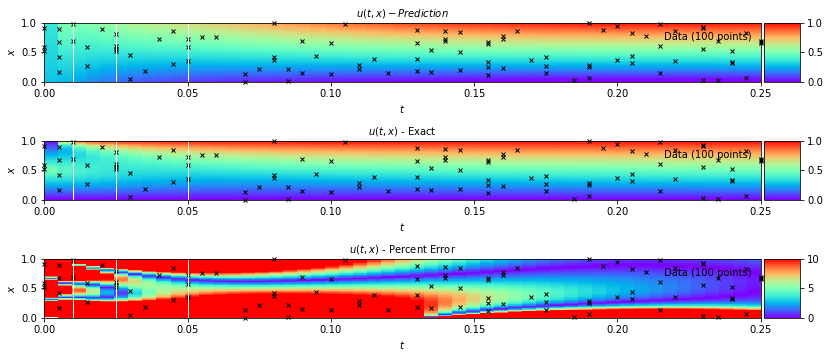

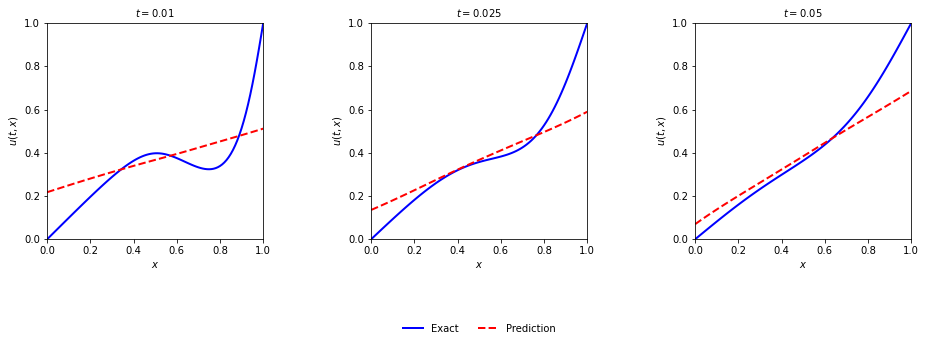

In [56]:
fig, ax = plt.subplots(figsize=(15,15))
ax.axis('off')

print("--------- Errors ---------")
print('Percent error u: ',  100*error_u)
print("--------------------------")


####### Row 0: u(t,x) ##################
gs0 = gridspec.GridSpec(3, 2)
gs0.update(top=1-0.06, bottom=1-1/3, left=0.15, right=0.85, wspace=0, hspace=1)


########## Prediction ##################
ax = plt.subplot(gs0[0, :])
h = ax.imshow(U_pred.T, interpolation='nearest', cmap='rainbow',
              extent=[t.min(), t.max(), x.min(), x.max()],
              origin='lower', aspect='auto', vmin = 0, vmax = 1)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
fig.colorbar(h, cax=cax)

ax.plot(X_u_train[:,1], X_u_train[:,0], 'kx', label = 'Data (%d points)' % (u_train.shape[0]), markersize = 4, clip_on = False)

line = np.linspace(x.min(), x.max(), 2)[:,None]
ax.plot(t[2]*np.ones((2,1)), line, 'w-', linewidth = 1)
ax.plot(t[5]*np.ones((2,1)), line, 'w-', linewidth = 1)
ax.plot(t[10]*np.ones((2,1)), line, 'w-', linewidth = 1)

ax.set_xlabel('$t$')
ax.set_ylabel('$x$')
ax.legend(frameon=False, loc = 'best')
ax.set_title('$u(t,x) - Prediction$', fontsize = 10)

########## Exact ##################
ax = plt.subplot(gs0[1, :])
i = ax.imshow(Exact.T, interpolation='nearest', cmap='rainbow',
              extent=[t.min(), t.max(), x.min(), x.max()],
              origin='lower', aspect='auto', vmin = 0, vmax = 1)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
fig.colorbar(i, cax=cax)

ax.plot(X_u_train[:,1], X_u_train[:,0], 'kx', label = 'Data (%d points)' % (u_train.shape[0]), markersize = 4, clip_on = False)

line = np.linspace(x.min(), x.max(), 2)[:,None]
ax.plot(t[2]*np.ones((2,1)), line, 'w-', linewidth = 1)
ax.plot(t[5]*np.ones((2,1)), line, 'w-', linewidth = 1)
ax.plot(t[10]*np.ones((2,1)), line, 'w-', linewidth = 1)

ax.set_xlabel('$t$')
ax.set_ylabel('$x$')
ax.legend(frameon=False, loc = 'best')
ax.set_title('$u(t,x)$ - Exact', fontsize = 10)

########## Error ##################
ax = plt.subplot(gs0[2, :])
j = ax.imshow(percentError.T, interpolation='nearest', cmap='rainbow',
              extent=[t.min(), t.max(), x.min(), x.max()],
              origin='lower', aspect='auto', vmin = 0, vmax = 10)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
fig.colorbar(j, cax=cax)

ax.plot(X_u_train[:,1], X_u_train[:,0], 'kx', label = 'Data (%d points)' % (u_train.shape[0]), markersize = 4, clip_on = False)

line = np.linspace(x.min(), x.max(), 2)[:,None]
ax.plot(t[2]*np.ones((2,1)), line, 'w-', linewidth = 1)
ax.plot(t[5]*np.ones((2,1)), line, 'w-', linewidth = 1)
ax.plot(t[10]*np.ones((2,1)), line, 'w-', linewidth = 1)

ax.set_xlabel('$t$')
ax.set_ylabel('$x$')
ax.legend(frameon=False, loc = 'best')
ax.set_title('$u(t,x)$ - Percent Error', fontsize = 10)

####### Row 1: u(t,x) slices ##################

fig, ax = plt.subplots(figsize=(15,15))
ax.axis('off')
gs1 = gridspec.GridSpec(1, 3)
gs1.update(top=1-1/3, bottom=0, left=0.1, right=0.9, wspace=0.5)

ax = plt.subplot(gs1[:, 0])
ax.plot(x,Exact[2,:], 'b-', linewidth = 2, label = 'Exact')
ax.plot(x,U_pred[2,:], 'r--', linewidth = 2, label = 'Prediction')
ax.set_xlabel('$x$')
ax.set_ylabel('$u(t,x)$')
ax.set_title('$t = ' + str(t[2,0]) + '$', fontsize = 10)
ax.axis('square')
ax.set_xlim([0,1])
ax.set_ylim([0,1])

ax = plt.subplot(gs1[:, 1])
ax.plot(x,Exact[5,:], 'b-', linewidth = 2, label = 'Exact')
ax.plot(x,U_pred[5,:], 'r--', linewidth = 2, label = 'Prediction')
ax.set_xlabel('$x$')
ax.set_ylabel('$u(t,x)$')
ax.axis('square')
ax.set_xlim([0,1])
ax.set_ylim([0,1])
ax.set_title('$t = ' + str(t[5,0]) + '$', fontsize = 10)
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.35), ncol=5, frameon=False)

ax = plt.subplot(gs1[:, 2])
ax.plot(x,Exact[10,:], 'b-', linewidth = 2, label = 'Exact')
ax.plot(x,U_pred[10,:], 'r--', linewidth = 2, label = 'Prediction')
ax.set_xlabel('$x$')
ax.set_ylabel('$u(t,x)$')
ax.axis('square')
ax.set_xlim([0,1])
ax.set_ylim([0,1])
ax.set_title('$t = ' + str(t[10,0]) + '$', fontsize = 10);




<div style="background-color: #ccffcc; padding: 10px;">

**Results**

Above are the results of the PINN. The error for recreating the full solution field is $\approx 3 \%$, despite using only $N_u = 100$ data points. This shows the power of PINNs to learn from sparse measurements by augmanting the available observational data with knowledge of the underlying physics (i.e. governing equations). 

The three colourmaps show the PINN prediction, the exact solution from the numerical method and the relative error between these two fields. We can see that the errors are largest near $t=0$ and $x=0$, but that overall the agreement is very good.

On the colourmap, we can see three vertical white lines, which show the location in time of the three profile plots of $u$ against $x$. The three heat profiles at these times are plotted against the exact solution found using numerical methods. The profiles can be seen to be in very good agreement, but show worse agreement.

**Further Work**

Congratulations, you have now trained your first physics-informed neural network!

This network contains a number of hyper-parameters that could be tuned to give better results. Various hyper-parameters include:
- number of data training points N_u
- number of collocation training points N_f
- number of layers in the network
- number of neurons per layer
- weightings for the data and PDE loss terms in the loss function (currently we use loss = loss_PDE + 5*loss_data)

It is also possible to use different sampling techniques for training data points. We randomly select $N_u$ data points, but alternative methods could be choosing only boundary points or choosing more points near the $t=0$ boundary. Choosing boundary points for training could help to reduce the errors seen in these regions.

Feel free to try out some of these changes if you like!

There are 3 subsequent PINNs notebooks to follow, which look at the inverse heat equation problem and two Navier-Stokes fluid flow problems. 

</div>

<hr>


<div style="background-color: #e6ccff; padding: 10px;">
    
# Next Steps
    
    
Next we move on to a more complex example using the Navier Stokes Equation in the notebook linked below
  
[Navier-Stokes PINNs discovery of PDE’s](PINNs_Navier_Stokes_example.ipynb)
    
 <hr>

**Contact Details** 

For any questions, corrections or comments, please contact either of the authors:

Michael MacRaild - scmm@leeds.ac.uk

Fergus Shone - mm16f2s@leeds.ac.uk
    
</div>